# Importing libraries

In [1]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, GRU, Dense
from sklearn.metrics import mean_absolute_percentage_error
from tensorflow.keras.optimizers import Adam

# Data load and processing

We will need to download and load the data for this competition. The data consists of two files: `train.csv` and `test.csv`. We will load the data using the `pandas` library and perform some initial data processing steps.

## Download relevant files

In [2]:
# !kaggle competitions download -c playground-series-s5e1
# # unzip kaggel data
# !unzip playground-series-s5e1.zip

In [3]:
# Load dataset
train_data = pd.read_csv('train.csv')
test_data=pd.read_csv('test.csv')

## Preprocess data

In [4]:
# Preprocessing
train_data['date'] = pd.to_datetime(train_data['date'])
train_data['Year'] = train_data['date'].dt.year
train_data['Month'] = train_data['date'].dt.month
train_data['Day'] = train_data['date'].dt.day
train_data = train_data.drop(['id', 'date'], axis=1)

In [5]:
train_data.head()

,country,store,product,num_sold,Year,Month,Day
0,Canada,Discount Stickers,Holographic Goose,NaN,2010,1,1
1,Canada,Discount Stickers,Kaggle,973.0,2010,1,1
2,Canada,Discount Stickers,Kaggle Tiers,906.0,2010,1,1
3,Canada,Discount Stickers,Kerneler,423.0,2010,1,1
4,Canada,Discount Stickers,Kerneler Dark Mode,491.0,2010,1,1


In [6]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 230130 entries, 0 to 230129
Data columns (total 7 columns):
 #   Column    Non-Null Count   Dtype  
---  ------    --------------   -----  
 0   country   230130 non-null  object 
 1   store     230130 non-null  object 
 2   product   230130 non-null  object 
 3   num_sold  221259 non-null  float64
 4   Year      230130 non-null  int32  
 5   Month     230130 non-null  int32  
 6   Day       230130 non-null  int32  
dtypes: float64(1), int32(3), object(3)
memory usage: 9.7+ MB


In [7]:
# plot distribution of categorical data
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Create subplots
fig = make_subplots(rows=1, cols=2, subplot_titles=('Distribution of Stores', 'Distribution of Countries'))

# Plot distribution of stores
fig_store = px.histogram(train_data, x='store')
fig.add_trace(fig_store['data'][0], row=1, col=1)

# Plot distribution of countries
fig_country = px.histogram(train_data, x='country')
fig.add_trace(fig_country['data'][0], row=1, col=2)

# Update x-axis titles
fig.update_xaxes(title_text='Store', row=1, col=1)
fig.update_xaxes(title_text='Country', row=1, col=2)

# Update layout
fig.update_layout(title_text='Distribution of Stores and Countries')
fig.show()

In [8]:
# plot distribution of num_sold
import plotly.express as px

fig = px.histogram(train_data, x='num_sold', title='Distribution of num_sold')
fig.show()

In [9]:
# plot distribution of num_sold
import plotly.express as px

fig = px.box(train_data, y='num_sold', title='Distribution of num_sold')
fig.show()

In [25]:
train_data['num_sold'] = np.log1p(train_data['num_sold'])
train_data['num_sold'] = np.log1p(train_data['num_sold'])
fig = px.box(train_data, y='num_sold', title='Distribution of num_sold')
fig.show()

In [11]:
missing_num_sold = train_data[train_data['num_sold'].isnull()]
missing_num_sold.head()

,country,store,product,num_sold,Year,Month,Day
0,Canada,Discount Stickers,Holographic Goose,NaN,2010,1,1
45,Kenya,Discount Stickers,Holographic Goose,NaN,2010,1,1
90,Canada,Discount Stickers,Holographic Goose,NaN,2010,1,2
135,Kenya,Discount Stickers,Holographic Goose,NaN,2010,1,2
180,Canada,Discount Stickers,Holographic Goose,NaN,2010,1,3


In [12]:
# plot the distribution of the predictors for the missing values

# Plot distribution of stores
fig= px.histogram(missing_num_sold, x='store')
fig.show()

In [13]:
# plot the distribution of the predictors for the missing values

# Plot distribution of country
fig= px.histogram(missing_num_sold, x='country', color='store')
fig.show()

In [14]:
# plot the distribution of the predictors for the missing values

# Plot distribution of country
fig= px.histogram(missing_num_sold, x='product', color='country')
fig.show()

In [ ]:
from sklearn.preprocessing import OneHotEncoder

# One-hot encode categorical columns
categorical_cols = ['country', 'store', 'product']
one_hot_encoder = OneHotEncoder(sparse_output=False,drop='first')
encoded_features = one_hot_encoder.fit_transform(train_data[categorical_cols])

# Create a DataFrame with the encoded features
encoded_df = pd.DataFrame(encoded_features, columns=one_hot_encoder.get_feature_names_out(categorical_cols).T)

# Concatenate the encoded features with the original DataFrame (excluding the original categorical columns)
train_data = pd.concat([train_data.drop(columns=categorical_cols), encoded_df], axis=1)

train_data.head()

In [16]:
# Create a KNN imputer to fill the missing values
from sklearn.impute import KNNImputer

# Create a KNN imputer
knn_imputer = KNNImputer(n_neighbors=5)

# Fill missing values
train_data_filled = knn_imputer.fit_transform(train_data)
train_data = pd.DataFrame(train_data_filled, columns=train_data.columns)
train_data.head()

,num_sold,Year,Month,Day,country_Finland,country_Italy,country_Kenya,country_Norway,country_Singapore,store_Premium Sticker Mart,store_Stickers for Less,product_Kaggle,product_Kaggle Tiers,product_Kerneler,product_Kerneler Dark Mode
0,5.624031,2010.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,6.881411,2010.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
2,6.810142,2010.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,6.049733,2010.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,6.198479,2010.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [17]:
# Split features and target
X = train_data.drop('num_sold', axis=1)
y = train_data['num_sold']

# Train-validation split
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=42)

# Ensure that X and y have the same number of samples
train_data = train_data.dropna(subset=['num_sold'])  # Drop rows where 'num_sold' is NaN

# Split features and target again after dropping rows with NaN in the target
X = train_data.drop('num_sold', axis=1)
y = train_data['num_sold']

# Train-validation split
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=42)

# Scale input features
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_valid_scaled = scaler.transform(X_valid)

# Scale target variable
target_scaler = StandardScaler()
y_train_scaled = target_scaler.fit_transform(y_train.values.reshape(-1, 1))
y_valid_scaled = target_scaler.transform(y_valid.values.reshape(-1, 1))

# Ensure the same length after scaling
print(f"X_train_scaled shape: {X_train_scaled.shape}")
print(f"y_train_scaled shape: {y_train_scaled.shape}")


# Reshape inputs for LSTM
X_train_reshaped = X_train_scaled.reshape(X_train_scaled.shape[0], 1, X_train_scaled.shape[1])
X_valid_reshaped = X_valid_scaled.reshape(X_valid_scaled.shape[0], 1, X_valid_scaled.shape[1])


X_train_scaled shape: (184104, 14)
y_train_scaled shape: (184104, 1)


# LSTM

We will use a Long Short Term Memory (LSTM) model to predict the sticker sales in the dataset.
The LSTM model is a type of recurrent neural network that is well-suited to sequence prediction problems,
we can model the problem as a recurrent neural network and use the LSTM model to predict the sticker sales.


In [18]:
from tensorflow.keras.layers import Dropout
from tensorflow.keras.callbacks import EarlyStopping

lstm_model = Sequential()
lstm_model.add(LSTM(units=50, activation='relu', return_sequences=True, input_shape=(X_train_reshaped.shape[1], X_train_reshaped.shape[2])))
lstm_model.add(Dropout(0.2))
lstm_model.add(LSTM(units=50, activation='relu', return_sequences=True))
lstm_model.add(Dropout(0.2))
lstm_model.add(LSTM(units=50, activation='relu'))
lstm_model.add(Dropout(0.2))
lstm_model.add(Dense(1))

lstm_model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')

# Define early stopping callback
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)


lstm_model.summary()


# Train the model
history = lstm_model.fit(X_train_reshaped, y_train_scaled, epochs=20, batch_size=32, validation_data=(X_valid_reshaped, y_valid_scaled), callbacks=[early_stopping])


/Users/ngtzekean/Github/Kaggle-Forecasting-Sticker-Sales/.venv/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:200: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                     │ (None, 1, 50)          │        13,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 1, 50)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_1 (LSTM)                   │ (None, 1, 50)          │        20,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 1, 50)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_2 (LSTM)                   │ (None, 50)             │        20,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 50)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1)              │            51 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 53,451 (208.79 KB)

 Trainable params: 53,451 (208.79 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
5754/5754 ━━━━━━━━━━━━━━━━━━━━ 10s 1ms/step - loss: 0.1352 - val_loss: 0.0142
Epoch 2/20
5754/5754 ━━━━━━━━━━━━━━━━━━━━ 8s 1ms/step - loss: 0.0303 - val_loss: 0.0143
Epoch 3/20
5754/5754 ━━━━━━━━━━━━━━━━━━━━ 7s 1ms/step - loss: 0.0272 - val_loss: 0.0108
Epoch 4/20
5754/5754 ━━━━━━━━━━━━━━━━━━━━ 8s 1ms/step - loss: 0.0256 - val_loss: 0.0114
Epoch 5/20
5754/5754 ━━━━━━━━━━━━━━━━━━━━ 8s 1ms/step - loss: 0.0246 - val_loss: 0.0100
Epoch 6/20
5754/5754 ━━━━━━━━━━━━━━━━━━━━ 8s 1ms/step - loss: 0.0239 - val_loss: 0.0097
Epoch 7/20
5754/5754 ━━━━━━━━━━━━━━━━━━━━ 8s 1ms/step - loss: 0.0232 - val_loss: 0.0095
Epoch 8/20
5754/5754 ━━━━━━━━━━━━━━━━━━━━ 8s 1ms/step - loss: 0.0230 - val_loss: 0.0089
Epoch 9/20
5754/5754 ━━━━━━━━━━━━━━━━━━━━ 9s 1ms/step - loss: 0.0223 - val_loss: 0.0092
Epoch 10/20
5754/5754 ━━━━━━━━━━━━━━━━━━━━ 8s 1ms/step - loss: 0.0220 - val_loss: 0.0092
Epoch 11/20
5754/5754 ━━━━━━━━━━━━━━━━━━━━ 8s 1ms/step - loss: 0.0218 - val_loss: 0.0106
Epoch 12/20
5754/5754 ━━━━━━━

In [19]:
y_valid_pred = lstm_model.predict(X_valid_reshaped)
y_valid_pred = target_scaler.inverse_transform(y_valid_pred)  # Convert predictions back to original scale
y_valid_pred_original = np.expm1(y_valid_pred)
print(y_valid_pred_original)

# Calculate MAPE on the validation data
from sklearn.metrics import mean_absolute_percentage_error
mape = mean_absolute_percentage_error(np.expm1(y_valid), np.expm1(y_valid_pred))
print(f"LSTM Validation MAPE: {mape}")

1439/1439 ━━━━━━━━━━━━━━━━━━━━ 1s 433us/step
[[ 641.4158 ]
 [1188.1472 ]
 [ 265.94275]
 ...
 [ 614.42566]
 [2024.2687 ]
 [ 602.5873 ]]
LSTM Validation MAPE: 0.09912942026173686


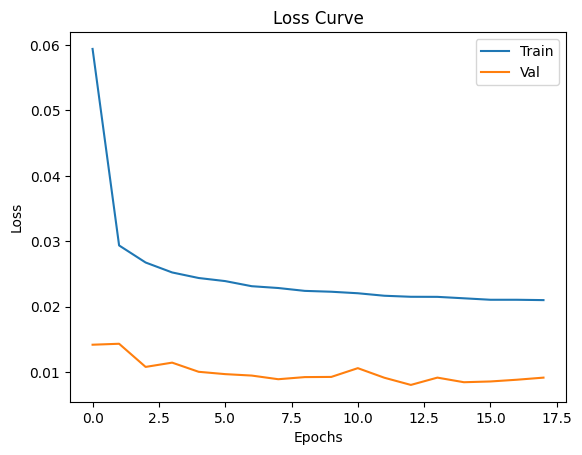

In [20]:
import matplotlib.pyplot as plt
plt.plot(history.history['loss'], label='Train')
plt.plot(history.history['val_loss'], label='Val')
plt.title('Loss Curve')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()


In [21]:
# Preprocess test data (apply the same transformations as done for training data)
test_data['date'] = pd.to_datetime(test_data['date'])
test_data['Year'] = test_data['date'].dt.year
test_data['Month'] = test_data['date'].dt.month
test_data['Day'] = test_data['date'].dt.day
test_data = test_data.drop(['id', 'date'], axis=1)

# Encode categorical columns in test data
encoded_features = one_hot_encoder.transform(test_data[categorical_cols])
encoded_df = pd.DataFrame(encoded_features, columns=one_hot_encoder.get_feature_names_out(categorical_cols).T)
test_data = pd.concat([test_data.drop(columns=categorical_cols), encoded_df], axis=1)

# Extract features (X_test) for the test data
X_test = test_data  # Replace this if there are any additional feature transformations

# Scale the test features
X_test_scaled = scaler.transform(X_test)

# Reshape the test features
X_test_reshaped = X_test_scaled.reshape(X_test_scaled.shape[0], 1, X_test_scaled.shape[1])

# Predict on the test data
y_test_pred = lstm_model.predict(X_test_reshaped)
y_test_pred = target_scaler.inverse_transform(y_test_pred)  # Convert predictions back to original scale
lstm_test_preds = np.expm1(y_test_pred)


3080/3080 ━━━━━━━━━━━━━━━━━━━━ 1s 346us/step


In [22]:
y_valid_pred

array([[6.4652357],
       [7.0809917],
       [5.587034 ],
       ...,
       [6.422314 ],
       [7.6134577],
       [6.4028907]], dtype=float32)

In [23]:
lstm_test_preds

array([[ 205.8667 ],
       [ 635.3201 ],
       [ 535.2299 ],
       ...,
       [1426.5668 ],
       [ 880.43256],
       [ 868.27057]], dtype=float32)

In [24]:
# Prepare the submission DataFrame
test_data=pd.read_csv('test.csv')
submission = pd.DataFrame({
    'id': test_data['id'],  # Assuming the 'id' column is in the test data
    'num_sold': lstm_test_preds.flatten()  # Flatten the predictions and reverse the log1p transformation
})

# Save the submission file
submission.to_csv('submission_lstm.csv', index=False)
submission

,id,num_sold
0,230130,205.866699
1,230131,635.320129
2,230132,535.229919
3,230133,265.360413
4,230134,368.494049
...,...,...
98545,328675,260.073181
98546,328676,1701.468628
98547,328677,1426.566772
98548,328678,880.432556
